Text(0.5, 1.0, 'Wave_coupled MLD03 monthly mean')

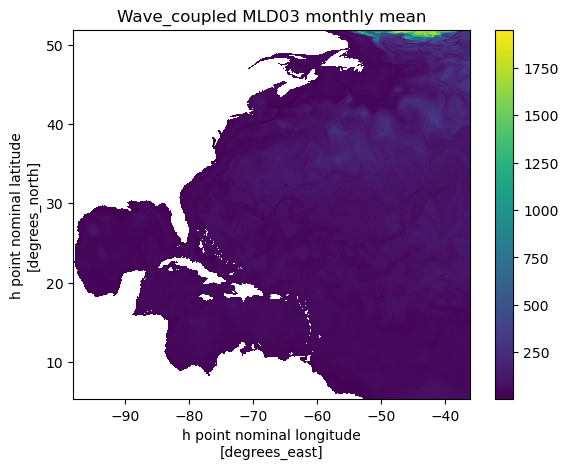

In [4]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray
import numpy as np
import logging


    # Ideally would use SSH, but some diag_tables only saved zos----for coupled waves
pp_root_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALT_wave/"
ocean_daily_wave= xarray.open_dataset(pp_root_wave+"19930101.ocean_daily.nc")
MLD03_wave=ocean_daily_wave.variables['MLD_003_daily']
t_wave=ocean_daily_wave.variables['time']
model_grid_x = ocean_daily_wave.variables['xh']
model_grid_y = ocean_daily_wave.variables['yh']

MLD03_wave_ave = MLD03_wave.mean('time')
#nx_wave=ocean_daily_wave.variables['x']
daMLD03_wave_ave=xarray.DataArray(MLD03_wave_ave, dims=['yh', 'xh'], coords={'xh': model_grid_x, 'yh': model_grid_y})
plt.figure()
daMLD03_wave_ave.plot()
plt.title('Wave_coupled MLD03 monthly mean')



Text(0.5, 1.0, 'Wavecoupled-MOM6 MLD03 monthly mean')

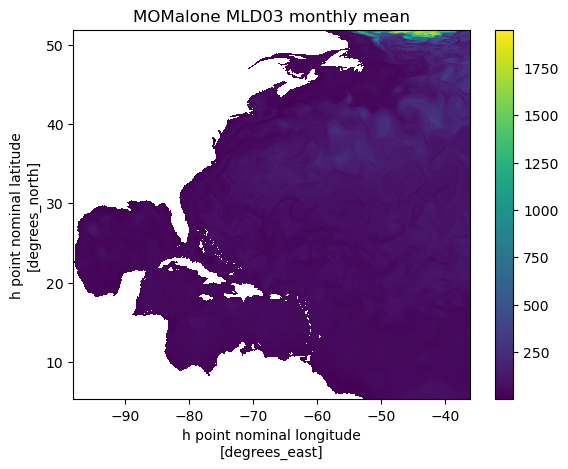

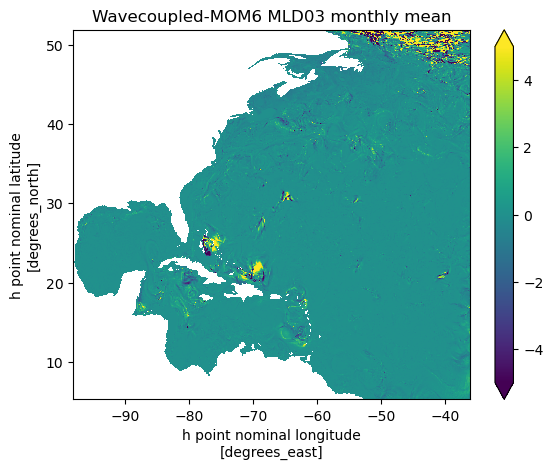

In [5]:

pp_root_uncou="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
ocean_daily= xarray.open_dataset(pp_root_uncou+"19930101.ocean_daily.nc")
MLD03=ocean_daily.variables['MLD_003_daily']

MLD03_ave = MLD03.mean('time')
daMLD03_ave=xarray.DataArray(MLD03_ave, dims=['yh', 'xh'], coords={'xh': model_grid_x, 'yh': model_grid_y})
plt.figure()
daMLD03_ave.plot()
plt.title('MOMalone MLD03 monthly mean')

diff_MDL03_ave=xarray.DataArray(MLD03_wave_ave-MLD03_ave, dims=['yh', 'xh'], coords={'xh': model_grid_x, 'yh': model_grid_y})
plt.figure()
diff_MDL03_ave.plot(vmin=-5,vmax=5)
plt.title('Wavecoupled-MOM6 MLD03 monthly mean')

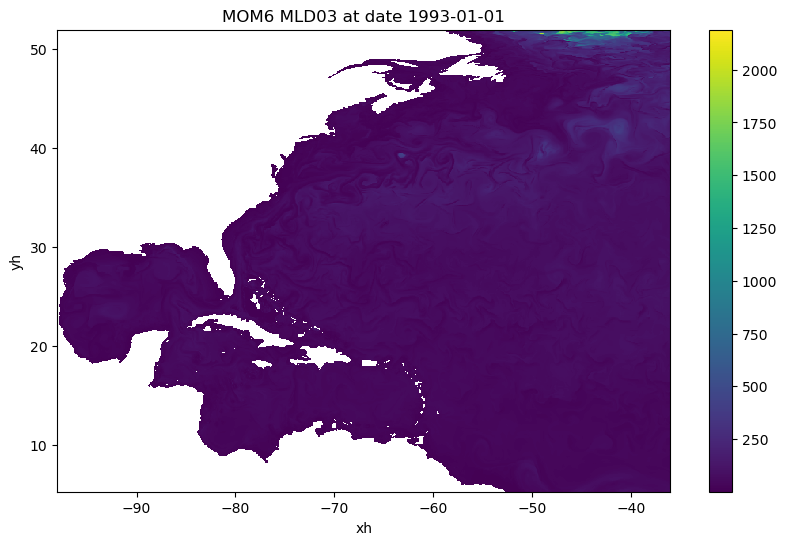

In [8]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.animation as animation
import pandas as pd

fig, ax = plt.subplots(figsize=(10, 6))
ax.set_aspect('equal')

min=MLD03.min()
max=MLD03.max()
cax = ax.imshow(MLD03[1,:,:], cmap='viridis',vmin=min,vmax=max)
cbar = fig.colorbar(cax)

def animate(i):
    ax.clear() 
    plths = ax.pcolormesh(model_grid_x,model_grid_y,MLD03[i,:,:],vmin=min,vmax=max)
    plt.xlabel('xh'); plt.ylabel('yh');
    t=str(t_wave[i])
    index = t.split("'")[1]
    index=index.split("T")[0]
    
    plt.title(f"MOM6 MLD03 at date {index}")
    return plths,
    


ani = FuncAnimation(fig, animate, frames=len(t_wave), blit=False)

writergif = animation.PillowWriter(fps=30)
ani.save('MOM6_MLD03_ani.gif', writer=writergif)
HTML(ani.to_jshtml())

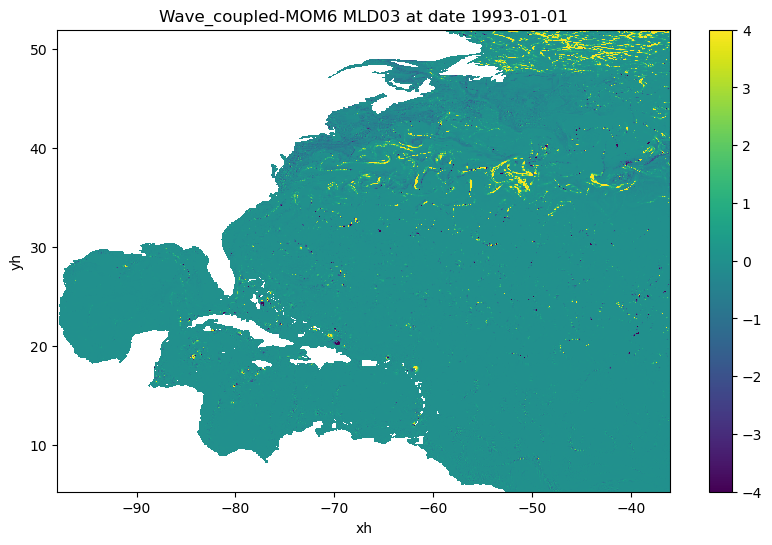

In [6]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.animation as animation
import pandas as pd

fig, ax = plt.subplots(figsize=(10, 6))
ax.set_aspect('equal')
diff_MLD03=MLD03_wave-MLD03
min=diff_MLD03.min()
max=diff_MLD03.max()
cax = ax.imshow(diff_MLD03[1,:,:], cmap='viridis',vmin=-4,vmax=4)
cbar = fig.colorbar(cax)

def animate(i):
    ax.clear() 
 
    plths = ax.pcolormesh(model_grid_x,model_grid_y,diff_MLD03[i,:,:],vmin=-4,vmax=4)
    plt.xlabel('xh'); plt.ylabel('yh');
    t=str(t_wave[i])
    index = t.split("'")[1]
    index=index.split("T")[0]   
    plt.title(f"Wave_coupled-MOM6 MLD03 at date {index}")
    return plths,
    


ani = FuncAnimation(fig, animate, frames=len(t_wave), blit=False)

writergif = animation.PillowWriter(fps=30)
ani.save('diff_MLD03_ani.gif', writer=writergif)
HTML(ani.to_jshtml())